In [28]:
import numpy as np
import matplotlib.pyplot as plt
import glob

thermal_ts = np.load("boson\\timestamps.npy")        # shape: (7202,)
visible_ts = np.load("u130vswir\\timestamps.npy")      # shape: (60,) 
print("Thermal timestamps shape:", thermal_ts.shape)
print("Visible timestamps shape:", visible_ts.shape)

# Match visible -> closest thermal
matched_indices = []

for v_ts in visible_ts:
    idx = np.argmin(np.abs(thermal_ts - v_ts))
    matched_indices.append(idx)

matched_indices = np.array(matched_indices)
print("Matched indices shape:", matched_indices.shape)
matched_indices
matched_indices[:60] 

Thermal timestamps shape: (7202,)
Visible timestamps shape: (7200,)
Matched indices shape: (7200,)


array([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
       31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47,
       48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64,
       65, 66, 67, 68, 69, 70, 71, 72, 73], dtype=int64)

In [ ]:
visible_file = 'u130vswir\\frameblock_00000.npy'
thermal_file = 'boson\\video.npy'

visible_frame = np.load(visible_file)
thermal_frame = np.load(thermal_file)
print("Visible frame shape:", visible_frame.shape)  #  (60, H, W, 1)
print("Thermal frame shape:", thermal_frame.shape)  # (7200, H, W)


Visible frame shape: (60, 1032, 1296, 1)
Thermal frame shape: (7202, 512, 640)


In [ ]:
visible_frames_all = sorted(glob.glob("u130vswir\\frameblock_*.npy"))
all_visible_ts = []

for ts_file in visible_frames_all:
    ts = np.load(ts_file)
    all_visible_ts.append(ts)

print("All visible timestamps shape:", np.array(all_visible_ts).shape)   # (120, 60, 1032, 1296, 1)
visible_frames = np.concatenate(all_visible_ts)  # (7200,)
print("Visible frames shape:", visible_frames.shape)  #  (7200, H, W, 1)

All visible timestamps shape: (120, 60, 1032, 1296, 1)
Visible frames shape: (7200, 1032, 1296, 1)


In [19]:
np.save("visible_frames_all.npy", visible_frames)

In [ ]:
vis = np.load("visible_frames_all.npy")  # Load all visible frames
print("Visible frames loaded, shape:", vis.shape)  #  (7200, H, W, 1)

Visible frames loaded, shape: (7200, 1032, 1296, 1)


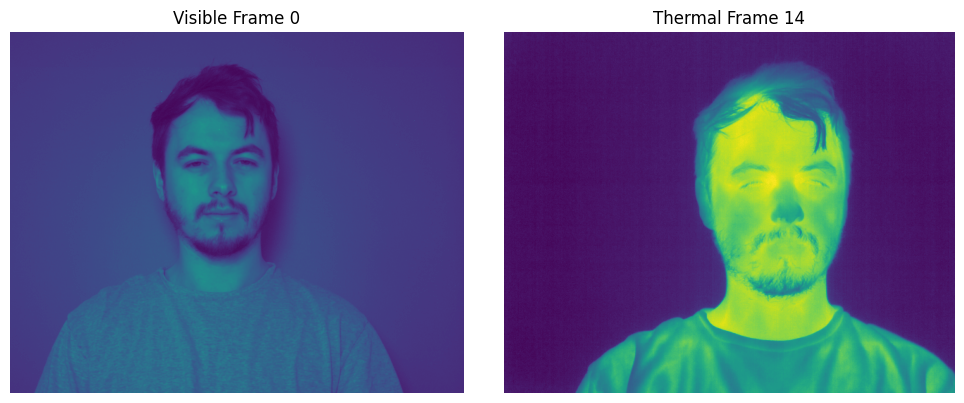

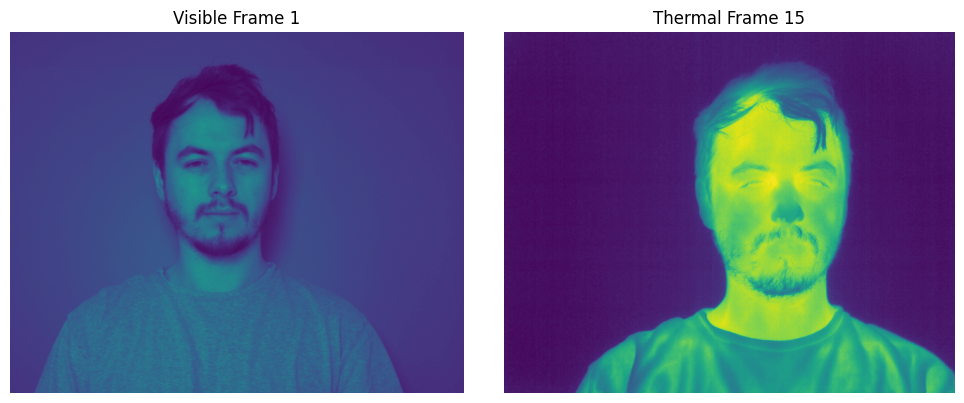

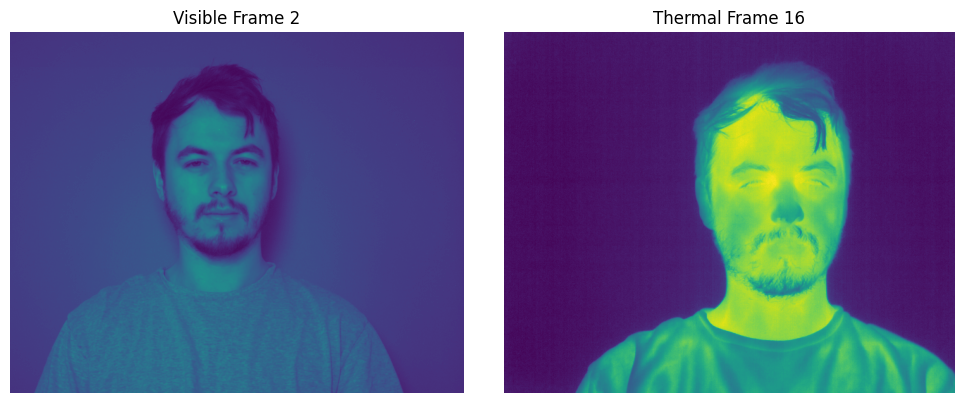

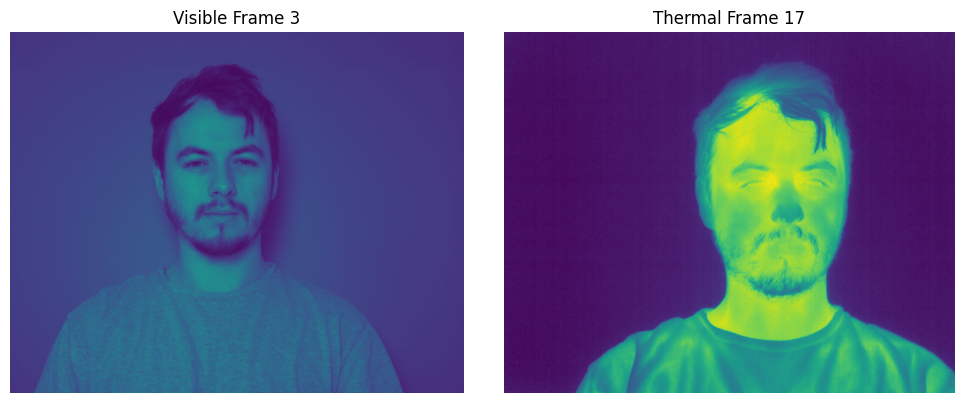

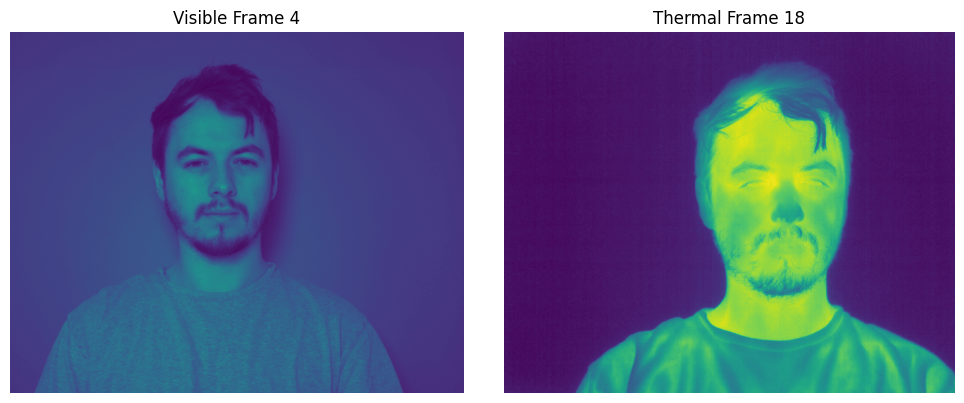

...

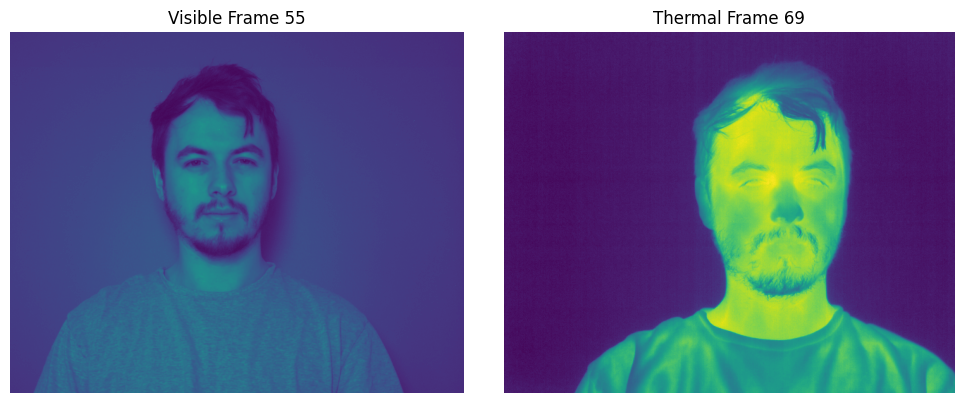

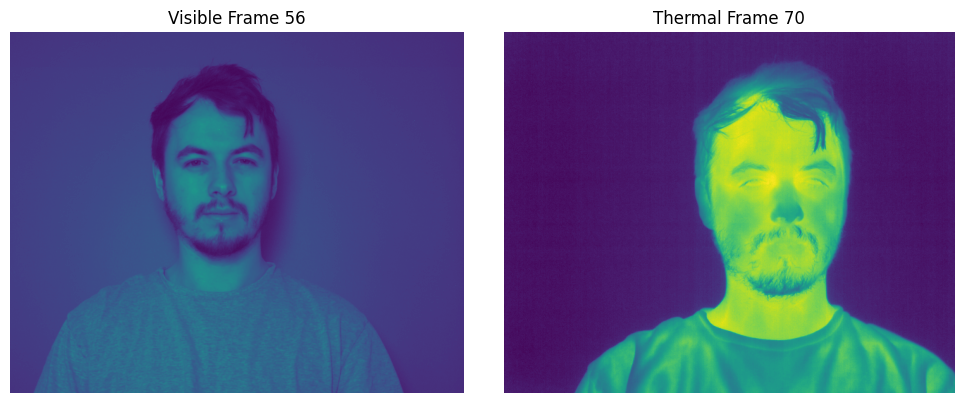

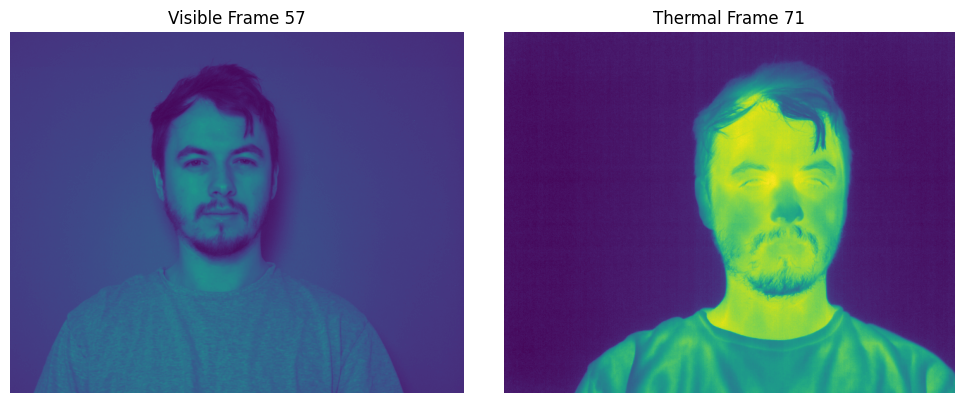

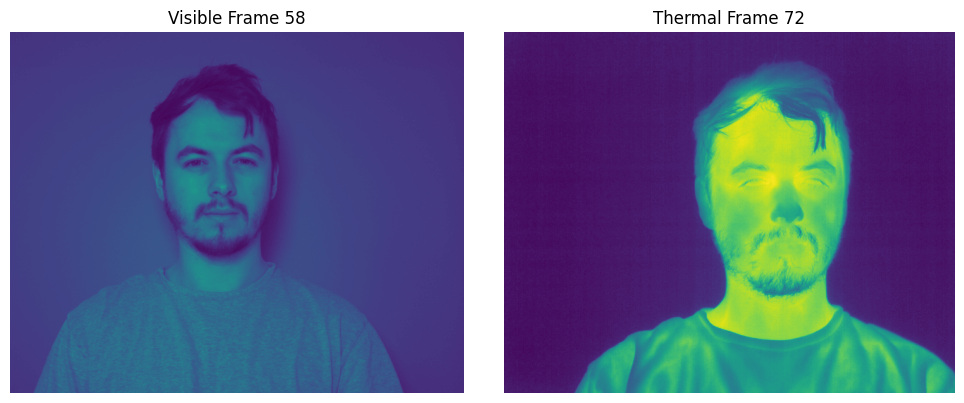

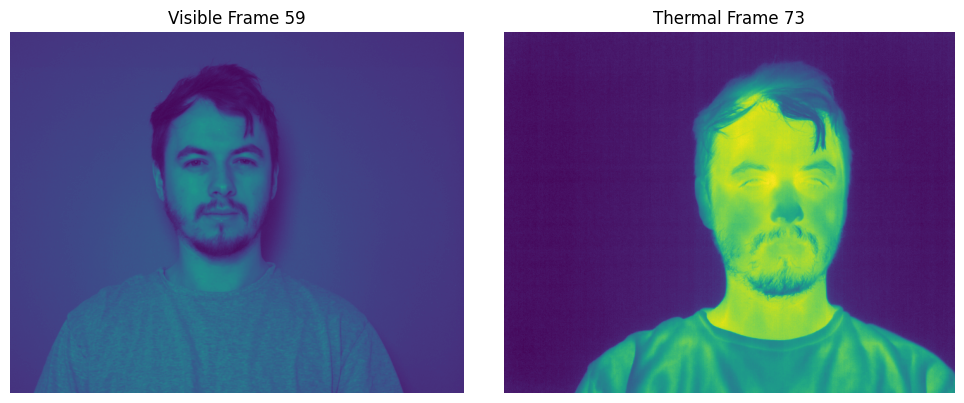

In [31]:
thermal_frame = np.load(thermal_file)  # reload as array

# for i, thermal_idx in enumerate(matched_indices[:85]):
#     visible_frame = visible_frames[i, 65:900, 50:1100, 0]  # crop & remove channel dim
#     thermal_frame1 = thermal_frame[thermal_idx]
ids = slice(0, 60)  # Example range for visualization
for i, (visible_frame, thermal_idx) in enumerate(zip(visible_frames[ids], matched_indices[ids]), start=ids.start):
    # Crop visible frame and remove channel dimension
    visible_frame_cropped = visible_frame[65:900, 50:1100, 0]
    thermal_frame1 = thermal_frame[thermal_idx]
    plt.figure(figsize=(10, 4))

    plt.subplot(1, 2, 1)
    plt.imshow(visible_frame)
    plt.title(f'Visible Frame {i}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(thermal_frame1)
    plt.title(f'Thermal Frame {thermal_idx}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
